In [ ]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! rm celebaprocessed.zip
! kaggle datasets download -d mohilpatel/celebaprocessed

mkdir: cannot create directory ‘/root/.kaggle’: File exists
rm: cannot remove 'celebaprocessed.zip': No such file or directory
 95% 122M/128M [00:01<00:00, 73.9MB/s]
100% 128M/128M [00:01<00:00, 88.4MB/s]


In [ ]:
! rm -r color
! rm -r bw
! unzip celebaprocessed.zip
#! cp celeba.zip /content/drive/MyDrive/dataset/MP

Streaming output truncated to the last 5000 lines.
  inflating: color/151762.jpg        
  inflating: color/151773.jpg        
  inflating: color/151775.jpg        
  inflating: color/151784.jpg        
  inflating: color/151793.jpg        
  inflating: color/151820.jpg        
  inflating: color/151831.jpg        
  inflating: color/151854.jpg        
  inflating: color/151863.jpg        
  inflating: color/151864.jpg        
  inflating: color/151867.jpg        
  inflating: color/151873.jpg        
  inflating: color/151886.jpg        
  inflating: color/151892.jpg        
  inflating: color/151907.jpg        
  inflating: color/151941.jpg        
  inflating: color/151966.jpg        
  inflating: color/151973.jpg        
  inflating: color/151979.jpg        
  inflating: color/151981.jpg        
  inflating: color/151988.jpg        
  inflating: color/151992.jpg        
  inflating: color/152010.jpg        
  inflating: color/152014.jpg        
  inflating: color/152029.jpg        

In [ ]:
# import the necessary packages
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Reshape

class DCGAN:
	@staticmethod
	def build_generator(dim, depth, channels=1, inputDim=100, outputDim=512):
		# initialize the model along with the input shape to be "channels last" and the channels dimension itself
		model = Sequential()
		inputShape = (dim, dim, depth)
		chanDim = -1

		# first set of FC => RELU => BN layers
		model.add(Dense(input_dim=inputDim, units=outputDim))
		model.add(Activation("relu"))
		model.add(BatchNormalization())

		# second set of FC => RELU => BN layers, this time preparing the number of FC nodes to be reshaped into a volume
		model.add(Dense(dim * dim * depth))
		model.add(Activation("relu"))
		model.add(BatchNormalization())

		# reshape the output of the previous layer set, upsample + apply a transposed convolution, RELU, and BN
		model.add(Reshape(inputShape))
		model.add(Conv2DTranspose(32, (5, 5), strides=(2, 2), padding="same"))
		model.add(Activation("relu"))
		model.add(BatchNormalization(axis=chanDim))

		# apply another upsample and transposed convolution, but this time output the TANH activation
		model.add(Conv2DTranspose(channels, (5, 5), strides=(2, 2), padding="same"))
		model.add(Activation("tanh"))

		# return the generator model
		return model

	@staticmethod
	def build_discriminator(width, height, depth, alpha=0.2):
		# initialize the model along with the input shape to be "channels last"
		model = Sequential()
		inputShape = (height, width, depth)

		# first set of CONV => RELU layers
		model.add(Conv2D(32, (5, 5), padding="same", strides=(2, 2), input_shape=inputShape))
		model.add(LeakyReLU(alpha=alpha))

		# second set of CONV => RELU layers
		model.add(Conv2D(64, (5, 5), padding="same", strides=(2, 2)))
		model.add(LeakyReLU(alpha=alpha))

		# first (and only) set of FC => RELU layers
		model.add(Flatten())
		model.add(Dense(512))
		model.add(LeakyReLU(alpha=alpha))

		# sigmoid layer outputting a single value
		model.add(Dense(1))
		model.add(Activation("sigmoid"))

		# return the discriminator model
		return model

In [ ]:
import os
from tqdm import tqdm
import numpy as np
from PIL import Image
inp_images = []
files = os.listdir('color')
for f in tqdm(range(len(files))):
  im = Image.open('color/'+files[f])  
  im = np.asarray(im)
  inp_images.append(im)
inp_images = np.array(inp_images)

100%|██████████| 20000/20000 [00:08<00:00, 2462.36it/s]


In [ ]:
inp_images.shape

(20000, 128, 128, 3)

In [ ]:
# USAGE
# python dcgan_fashion_mnist.py --output output
 
# import the necessary packages
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.datasets import fashion_mnist
from sklearn.utils import shuffle
from imutils import build_montages
import numpy as np
import argparse
import cv2
import os
 
NUM_EPOCHS = 80
BATCH_SIZE = 128
INIT_LR = 2e-4
 
trainImages = inp_images
#trainImages = np.expand_dims(trainImages, axis=-1)
trainImages = (trainImages.astype("float") - 127.5) / 127.5
 
# generator
gen = DCGAN.build_generator(32, 64, channels=3)
print(gen.summary())
# discriminator
disc = DCGAN.build_discriminator(128, 128, 3)
discOpt = Adam(lr=INIT_LR, beta_1=0.5, decay=INIT_LR / NUM_EPOCHS)
disc.compile(loss="binary_crossentropy", optimizer=discOpt)
print(disc.summary())

disc.trainable = False
ganInput = Input(shape=(100,))
ganOutput = disc(gen(ganInput))
gan = Model(ganInput, ganOutput)
 
# compile the GAN
ganOpt = Adam(lr=INIT_LR, beta_1=0.5, decay=INIT_LR / NUM_EPOCHS)
gan.compile(loss="binary_crossentropy", optimizer=discOpt)
 
print("Starting training...")
benchmarkNoise = np.random.uniform(-1, 1, size=(256, 100))
 
for epoch in range(0, NUM_EPOCHS):
    # show epoch information and compute the number of batches per epoch
    print("starting epoch {} of {}...".format(epoch + 1, NUM_EPOCHS))
    batchesPerEpoch = int(trainImages.shape[0] / BATCH_SIZE)
 
    # loop over the batches
    for i in range(0, batchesPerEpoch):
        # initialize an (empty) output path
        p = None
 
        imageBatch = trainImages[i * BATCH_SIZE:(i + 1) * BATCH_SIZE]
        noise = np.random.uniform(-1, 1, size=(BATCH_SIZE, 100))
 
        # generate images using the noise + generator model
        genImages = gen.predict(noise, verbose=0)
 
        X = np.concatenate((imageBatch, genImages))
        y = ([1] * BATCH_SIZE) + ([0] * BATCH_SIZE)
        y = np.reshape(y, (-1,))
        (X, y) = shuffle(X, y)
 
        # train the discriminator on the data
        discLoss = disc.train_on_batch(X, y)
 
        noise = np.random.uniform(-1, 1, (BATCH_SIZE, 100))
        fakeLabels = [1] * BATCH_SIZE
        fakeLabels = np.reshape(fakeLabels, (-1,))
        ganLoss = gan.train_on_batch(noise, fakeLabels)
 
        path = '/content/drive/MyDrive/dataset/MP/output/output4'   ###############################################
        if i == batchesPerEpoch - 1:
            p = [path, "epoch_{}_output.png".format(
                str(epoch + 1).zfill(4))]
 
        if p is not None:
            # show loss information
            print("Step {}_{}: discriminator_loss={:.6f}, adversarial_loss={:.6f}".format(epoch + 1, i, discLoss, ganLoss))
 
            # make predictions on the benchmark noise, scale it back to the range [0, 255], and generate the montage
            images = gen.predict(benchmarkNoise)
            images = ((images * 127.5) + 127.5).astype("uint8")
            #images = np.repeat(images, 3, axis=-1)
            vis = build_montages(images, (128, 128), (5, 5))[0]
            p = os.path.sep.join(p)
            cv2.imwrite(p, vis)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 512)               51712     
_________________________________________________________________
activation (Activation)      (None, 512)               0         
_________________________________________________________________
batch_normalization (BatchNo (None, 512)               2048      
_________________________________________________________________
dense_1 (Dense)              (None, 65536)             33619968  
_________________________________________________________________
activation_1 (Activation)    (None, 65536)             0         
_________________________________________________________________
batch_normalization_1 (Batch (None, 65536)             262144    
_________________________________________________________________
reshape (Reshape)            (None, 32, 32, 64)        0

KeyboardInterrupt: ignored

In [ ]:
from PIL import Image
import os

files = os.listdir('/content/drive/MyDrive/dataset/MP/output/output2')
out_images = []
for filename in files:
  im = Image.open('/content/drive/MyDrive/dataset/MP/output/output2/'+filename)
  out_images.append(im)

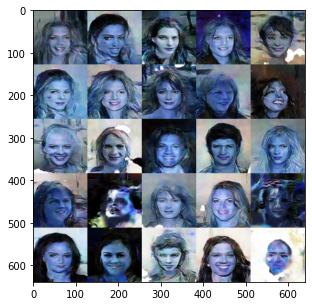

In [ ]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import rc

fig = plt.figure(figsize=(5,5))

ims = []
for i in range(len(out_images)):
    im = plt.imshow(out_images[i], animated=True)
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=150, blit=True, repeat_delay=1000)

matplotlib.rcParams["animation.embed_limit"] = 2**128
rc('animation', html='jshtml')
ani

In [ ]:
import tensorflow as tf

# gen = tf.keras.models.load_model('/content/drive/MyDrive/dataset/MP/gen1.h5')
# gen.save('/content/drive/MyDrive/dataset/MP/gen1.h5')

In [ ]:
newgen = tf.keras.models.load_model('/content/drive/MyDrive/dataset/MP/gen1.h5')

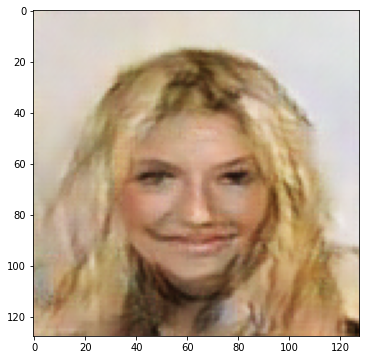

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

randomnoise = np.random.uniform(-1, 1, size=(1, 100))
randomimage = newgen.predict(randomnoise)
randomimage = ((randomimage * 127.5) + 127.5).astype("uint8")

plt.figure(figsize=(6,6))
plt.imshow(randomimage.reshape(randomimage.shape[1:]))